In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/playground-series-s5e11/sample_submission.csv
/kaggle/input/playground-series-s5e11/train.csv
/kaggle/input/playground-series-s5e11/test.csv


In [ ]:
import pandas as pd
import numpy as np
import warnings
import gc
import time
from typing import Dict, List, Tuple
warnings.filterwarnings('ignore')

# ML
from sklearn.model_selection import StratifiedKFold
from sklearn.preprocessing import QuantileTransformer, LabelEncoder
from sklearn.linear_model import RidgeCV
from sklearn.metrics import roc_auc_score, roc_curve
from sklearn.ensemble import RandomForestClassifier

# Models
import xgboost as xgb
import lightgbm as lgb
import catboost as ctb
import tensorflow as tf
from tensorflow.keras import layers, callbacks

# Visualization
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
import plotly.express as px
from tqdm import tqdm

# 1. CONFIGURATION

<div style="background-color: #f5f5f5; color: black; border: 2px solid black; padding: 15px; margin: 15px; font-size: 18px;">
Centralized configuration for all model parameters and training settings.<br>
Defines hyperparameters, feature lists, random seeds, and early stopping criteria.
</div>

In [ ]:
class Config:
    SEED = 42
    N_FOLDS = 7
    EARLY_STOP = 200

    CAT_FEATURES = ['gender', 'marital_status', 'education_level',
                   'employment_status', 'loan_purpose', 'grade_subgrade']
    TE_FEATURES = ['employment_status', 'loan_purpose', 'education_level', 'grade_subgrade']

    # FIXED: Added enable_categorical for XGBoost
    XGB_PARAMS = {
        'n_estimators': 5000,
        'max_depth': 8,
        'learning_rate': 0.01,
        'subsample': 0.8,
        'colsample_bytree': 0.7,
        'reg_alpha': 0.2,
        'reg_lambda': 0.8,
        'gamma': 0.1,
        'tree_method': 'gpu_hist',
        'gpu_id': 0,
        'random_state': SEED,
        'eval_metric': 'auc',
        'enable_categorical': True
    }
    
    LGB_PARAMS = {
        'n_estimators': 5000,
        'max_depth': 9,
        'learning_rate': 0.01,
        'num_leaves': 127,
        'subsample': 0.8,
        'colsample_bytree': 0.7,
        'reg_alpha': 0.2,
        'reg_lambda': 0.8,
        'min_child_samples': 25,
        'n_jobs': -1,
        'random_state': SEED
    }
    
    CTB_PARAMS = {
        'iterations': 5000,
        'depth': 8,
        'learning_rate': 0.015,
        'l2_leaf_reg': 5,
        'random_strength': 1,
        'bagging_temperature': 0.8,
        'task_type': 'GPU',
        'devices': '0',
        'random_seed': SEED,
        'early_stopping_rounds': EARLY_STOP,
        'verbose': False
    }

# 2. COMPREHENSIVE EDA

<div style="background-color: #f5f5f5; color: black; border: 2px solid black; padding: 15px; margin: 15px; font-size: 18px;">
Performs extensive exploratory data analysis with multiple visualizations.<br>
Analyzes target distribution, correlations, categorical variables, and feature importance.
</div>

In [ ]:
def perform_comprehensive_eda(train, test):
    """Perform extensive exploratory data analysis"""
    print("🔍 PERFORMING COMPREHENSIVE EDA")
    print("=" * 60)
    
    # Create a copy for EDA to avoid modifying original
    train_eda = train.copy()
    test_eda = test.copy()
    
    # Basic info
    print(f"Train shape: {train_eda.shape}")
    print(f"Test shape: {test_eda.shape}")
    print(f"Target distribution: {train_eda['loan_paid_back'].value_counts(normalize=True)}")
    
    # Create EDA visualizations
    fig, axes = plt.subplots(3, 3, figsize=(20, 15))
    fig.suptitle('Comprehensive EDA - Loan Dataset', fontsize=16, fontweight='bold')
    
    # 1. Target distribution
    target_counts = train_eda['loan_paid_back'].value_counts()
    axes[0,0].pie(target_counts.values, labels=['Paid', 'Default'], autopct='%1.1f%%', 
                  colors=['lightgreen', 'lightcoral'], startangle=90)
    axes[0,0].set_title('Loan Repayment Distribution')
    
    # 2. Numerical distributions
    numerical_cols = ['annual_income', 'loan_amount', 'credit_score', 'interest_rate']
    for i, col in enumerate(numerical_cols[:4]):
        row, col_idx = i // 2, i % 2
        axes[0,1].hist(train_eda[col], bins=50, alpha=0.7, label=col)
    axes[0,1].legend()
    axes[0,1].set_title('Numerical Features Distribution')
    
    # 3. Categorical analysis - Employment
    emp_repayment = train_eda.groupby('employment_status')['loan_paid_back'].mean().sort_values(ascending=False)
    axes[0,2].bar(emp_repayment.index, emp_repayment.values, color='lightblue')
    axes[0,2].set_title('Repayment Rate by Employment')
    axes[0,2].tick_params(axis='x', rotation=45)
    
    # 4. Categorical analysis - Loan Purpose
    purpose_repayment = train_eda.groupby('loan_purpose')['loan_paid_back'].mean().sort_values(ascending=False)
    axes[1,0].bar(purpose_repayment.index, purpose_repayment.values, color='lightcoral')
    axes[1,0].set_title('Repayment Rate by Loan Purpose')
    axes[1,0].tick_params(axis='x', rotation=45)
    
    # 5. Grade analysis
    train_eda['grade'] = train_eda['grade_subgrade'].str[0]
    grade_repayment = train_eda.groupby('grade')['loan_paid_back'].mean().sort_index()
    axes[1,1].bar(grade_repayment.index, grade_repayment.values, color='lightgreen')
    axes[1,1].set_title('Repayment Rate by Grade')
    
    # 6. Correlation heatmap
    numerical_features = ['annual_income', 'debt_to_income_ratio', 'credit_score', 
                         'loan_amount', 'interest_rate', 'loan_paid_back']
    corr_matrix = train_eda[numerical_features].corr()
    sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', center=0, ax=axes[1,2])
    axes[1,2].set_title('Feature Correlation Heatmap')
    
    # 7. Credit Score vs Interest Rate
    scatter = axes[2,0].scatter(train_eda['credit_score'], train_eda['interest_rate'], 
                               c=train_eda['loan_paid_back'], alpha=0.5, cmap='RdYlGn')
    axes[2,0].set_xlabel('Credit Score')
    axes[2,0].set_ylabel('Interest Rate')
    axes[2,0].set_title('Credit Score vs Interest Rate')
    plt.colorbar(scatter, ax=axes[2,0])
    
    # 8. Income vs Loan Amount
    scatter = axes[2,1].scatter(train_eda['annual_income'], train_eda['loan_amount'], 
                               c=train_eda['loan_paid_back'], alpha=0.5, cmap='RdYlGn')
    axes[2,1].set_xlabel('Annual Income')
    axes[2,1].set_ylabel('Loan Amount')
    axes[2,1].set_title('Income vs Loan Amount')
    plt.colorbar(scatter, ax=axes[2,1])
    
    # 9. Feature importance (quick)
    X_temp = train_eda[numerical_features].drop('loan_paid_back', axis=1)
    y_temp = train_eda['loan_paid_back']
    rf = RandomForestClassifier(n_estimators=100, random_state=42)
    rf.fit(X_temp, y_temp)
    feature_imp = pd.DataFrame({'feature': X_temp.columns, 'importance': rf.feature_importances_})
    feature_imp = feature_imp.sort_values('importance', ascending=True)
    axes[2,2].barh(feature_imp['feature'], feature_imp['importance'], color='orange')
    axes[2,2].set_title('Quick Feature Importance')
    
    plt.tight_layout()
    plt.show()
    
    # Print key insights
    print("\n📊 KEY EDA INSIGHTS:")
    print(f"• Target Balance: {train_eda['loan_paid_back'].mean():.1%} repaid")
    print(f"• Best Employment: {emp_repayment.index[0]} ({emp_repayment.iloc[0]:.1%} repayment)")
    print(f"• Best Loan Purpose: {purpose_repayment.index[0]} ({purpose_repayment.iloc[0]:.1%} repayment)")
    print(f"• Strongest Correlation: Credit Score vs Interest Rate = {corr_matrix.loc['credit_score', 'interest_rate']:.3f}")
    print(f"• Most Important Feature: {feature_imp.iloc[-1]['feature']} ({feature_imp.iloc[-1]['importance']:.3f})")
    
    return emp_repayment, purpose_repayment, grade_repayment

# 3. DOMAIN-DRIVEN FEATURE ENGINEERING

<div style="background-color: #f5f5f5; color: black; border: 2px solid black; padding: 15px; margin: 15px; font-size: 18px;">
Creates advanced features based on EDA insights and domain knowledge.<br>
Builds financial ratios, risk scores, interaction features, and composite risk metrics.
</div>

In [ ]:
class DomainDrivenFE:
    def __init__(self, emp_repayment, purpose_repayment, grade_repayment):
        self.grade_map = {'A':1, 'B':2, 'C':3, 'D':4, 'E':5, 'F':6, 'G':7}
        self.emp_repayment = emp_repayment
        self.purpose_repayment = purpose_repayment
        self.grade_repayment = grade_repayment
        
        # Create risk scores based on EDA
        self.employment_risk = {
            'Employed': 1, 'Self-employed': 2, 'Retired': 3, 'Student': 4, 'Unemployed': 5
        }
        self.purpose_risk = {
            'Home': 1, 'Car': 2, 'Debt consolidation': 2, 'Education': 3, 
            'Medical': 3, 'Other': 4, 'Business': 5, 'Vacation': 5
        }
    
    def transform(self, df):
        d = df.copy()
        
        # ==================== CORE FINANCIAL RATIOS ====================
        d['income_to_loan'] = d['annual_income'] / (d['loan_amount'] + 1)
        d['affordability'] = d['annual_income'] * (1 - d['debt_to_income_ratio']) / (d['loan_amount'] + 1)
        d['debt_burden'] = d['annual_income'] * d['debt_to_income_ratio']
        d['credit_utilization'] = d['loan_amount'] / (d['annual_income'] + 1)
        
        # ==================== DOMAIN RISK SCORES ====================
        d['employment_risk_score'] = d['employment_status'].map(self.employment_risk)
        d['purpose_risk_score'] = d['loan_purpose'].map(self.purpose_risk)
        d['high_risk_employment'] = (d['employment_status'].isin(['Unemployed', 'Student'])).astype(int)
        d['high_risk_purpose'] = (d['loan_purpose'].isin(['Business', 'Vacation'])).astype(int)
        
        # ==================== LOAN CHARACTERISTICS ====================
        d['monthly_payment'] = d['loan_amount'] * d['interest_rate'] / 100 / 12
        d['payment_to_income'] = d['monthly_payment'] / (d['annual_income'] / 12 + 1)
        d['total_repayment'] = d['loan_amount'] * (1 + d['interest_rate'] / 100)
        d['interest_burden'] = d['loan_amount'] * d['interest_rate'] / 100
        
        # ==================== GRADE FEATURES ====================
        d['grade_num'] = d['grade_subgrade'].str[0].map(self.grade_map)
        d['subgrade_num'] = d['grade_subgrade'].str[1:].astype(int)
        d['grade_composite'] = d['grade_num'] * 10 + d['subgrade_num']
        d['grade_interest_risk'] = d['grade_num'] * d['interest_rate']
        d['high_grade_high_loan'] = ((d['grade_num'] >= 4) & (d['loan_amount'] > 15000)).astype(int)
        
        # ==================== INTERACTION FEATURES ====================
        d['credit_income_interaction'] = d['credit_score'] * np.log1p(d['annual_income'])
        d['dti_interest_interaction'] = d['debt_to_income_ratio'] * d['interest_rate']
        d['employment_purpose_risk'] = d['employment_risk_score'] * d['purpose_risk_score']
        d['risk_capacity'] = (d['credit_score'] / 850) * (1 - d['debt_to_income_ratio'])
        
        # ==================== COMPOSITE RISK SCORE ====================
        d['composite_risk_score'] = (
            d['debt_to_income_ratio'] * 0.3 + 
            (1 - d['credit_score']/850) * 0.25 +
            d['employment_risk_score']/5 * 0.2 +
            d['purpose_risk_score']/4 * 0.15 +
            d['grade_num']/7 * 0.1
        )
        
        # ==================== FINANCIAL HEALTH ====================
        d['safety_margin'] = (d['annual_income'] - d['loan_amount']) / (d['annual_income'] + 1)
        d['financial_flexibility'] = d['annual_income'] * (1 - d['debt_to_income_ratio']) - d['monthly_payment'] * 12
        
        # ==================== TRANSFORMATIONS ====================
        d['log_income'] = np.log1p(d['annual_income'])
        d['log_loan'] = np.log1p(d['loan_amount'])
        d['sqrt_credit'] = np.sqrt(d['credit_score'])
        
        # ==================== POLYNOMIAL FEATURES ====================
        d['credit_score_sq'] = d['credit_score'] ** 2
        d['income_sq'] = np.log1p(d['annual_income']) ** 2
        d['dti_sq'] = d['debt_to_income_ratio'] ** 2
        d['interest_sq'] = d['interest_rate'] ** 2
        
        # ==================== CATEGORICAL INTERACTIONS ====================
        d['employed_debt_consolidation'] = (
            (d['employment_status'] == 'Employed') & 
            (d['loan_purpose'] == 'Debt consolidation')
        ).astype(int)
        
        d['unemployed_high_risk'] = (
            (d['employment_status'] == 'Unemployed') & 
            (d['loan_purpose'].isin(['Business', 'Vacation']))
        ).astype(int)
        
        # ==================== SMART BINNING ====================
        d['income_bin'] = pd.cut(d['annual_income'], bins=5, labels=False)
        d['loan_bin'] = pd.cut(d['loan_amount'], bins=5, labels=False)
        d['credit_bin'] = pd.cut(d['credit_score'], bins=5, labels=False)
        d['dti_bin'] = pd.cut(d['debt_to_income_ratio'], bins=5, labels=False)
        
        return d

# 4. LEAKAGE-FREE TARGET ENCODER

<div style="background-color: #f5f5f5; color: black; border: 2px solid black; padding: 15px; margin: 15px; font-size: 18px;">
Implements fold-aware target encoding to prevent data leakage.<br>
Calculates target means only from training folds for validation and test data.
</div>

In [ ]:
class SafeTE:
    def __init__(self, cols):
        self.cols = cols
        self.global_means = {}
        self.fold_maps = {}
    
    def fit(self, X, y, folds):
        print("Fitting leakage-free target encoding...")
        self.global_means = {c: y.mean() for c in self.cols}
        
        for fold, (trn_idx, _) in enumerate(folds, 1):
            fold_map = {}
            for col in self.cols:
                te_series = y.iloc[trn_idx].groupby(X.iloc[trn_idx][col]).mean()
                fold_map[col] = te_series.to_dict()
            self.fold_maps[fold] = fold_map
    
    def transform(self, X, fold):
        d = X.copy()
        fold_map = self.fold_maps[fold]
        
        for col in self.cols:
            encoding_map = fold_map.get(col, {})
            d[f'te_{col}'] = d[col].map(encoding_map).fillna(self.global_means[col])
        
        return d

# 5. ENHANCED NEURAL NETWORK

<div style="background-color: #f5f5f5; color: black; border: 2px solid black; padding: 15px; margin: 15px; font-size: 18px;">
Builds advanced neural network architecture with multiple dense layers.<br>
Includes batch normalization, dropout, and advanced training callbacks.
</div>

In [ ]:
class EnhancedNN:
    def __init__(self, n_feat):
        self.scaler = QuantileTransformer(output_distribution='normal', random_state=Config.SEED)
        self.model = self._build(n_feat)
    
    def _build(self, n_feat):
        model = tf.keras.Sequential([
            layers.Input(shape=(n_feat,)),
            
            layers.Dense(512, activation='swish'), layers.BatchNormalization(), layers.Dropout(0.4),
            layers.Dense(256, activation='swish'), layers.BatchNormalization(), layers.Dropout(0.3),
            layers.Dense(128, activation='swish'), layers.BatchNormalization(), layers.Dropout(0.2),
            layers.Dense(64, activation='swish'), layers.BatchNormalization(), layers.Dropout(0.2),
            layers.Dense(32, activation='swish'), layers.BatchNormalization(), layers.Dropout(0.1),
            
            layers.Dense(1, activation='sigmoid')
        ])
        
        model.compile(
            optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
            loss='binary_crossentropy',
            metrics=[tf.keras.metrics.AUC(name='auc')]
        )
        return model
    
    def fit(self, X_trn, y_trn, X_val, y_val):
        X_trn_s = self.scaler.fit_transform(X_trn)
        X_val_s = self.scaler.transform(X_val)
        
        callbacks_list = [
            callbacks.EarlyStopping(
                monitor='val_auc', patience=40, mode='max', restore_best_weights=True
            ),
            callbacks.ReduceLROnPlateau(
                monitor='val_auc', factor=0.5, patience=15, min_lr=1e-7, mode='max'
            )
        ]
        
        history = self.model.fit(
            X_trn_s, y_trn,
            validation_data=(X_val_s, y_val),
            epochs=400,
            batch_size=2048,
            callbacks=callbacks_list,
            verbose=0
        )
        return history
    
    def predict(self, X):
        return self.model.predict(self.scaler.transform(X), verbose=0).ravel()

# 6. STACKING ENSEMBLE

<div style="background-color: #f5f5f5; color: black; border: 2px solid black; padding: 15px; margin: 15px; font-size: 18px;">
Creates second-level ensemble using out-of-fold predictions as features.<br>
Uses Ridge regression as meta-model to combine base model predictions.
</div>

In [ ]:
class StackingEnsemble:
    def __init__(self):
        self.meta_model = None
    
    def fit_predict(self, oof_predictions, test_predictions, y):
        """Create second-level ensemble using OOF predictions"""
        print("Creating stacking ensemble...")
        
        # Prepare meta-features
        meta_train = np.column_stack([oof_predictions[m] for m in oof_predictions])
        meta_test = np.column_stack([test_predictions[m] for m in test_predictions])
        
        # Try multiple meta-models
        meta_models = {
            'ridge': RidgeCV(alphas=[0.001, 0.01, 0.1, 1.0, 10.0], cv=5),
            'ridge_wide': RidgeCV(alphas=[0.0001, 0.001, 0.01, 0.1, 1.0, 10.0, 100.0], cv=5)
        }
        
        best_score = 0
        best_predictions = None
        best_model_name = None
        
        # Use 20% of data for meta-validation
        split_idx = int(0.8 * len(meta_train))
        
        for name, model in meta_models.items():
            X_meta_tr = meta_train[:split_idx]
            y_meta_tr = y[:split_idx]
            X_meta_val = meta_train[split_idx:]
            y_meta_val = y[split_idx:]
            
            model.fit(X_meta_tr, y_meta_tr)
            val_pred = model.predict(X_meta_val)
            score = roc_auc_score(y_meta_val, val_pred)
            
            print(f"  {name} meta-model AUC: {score:.6f}")
            
            if score > best_score:
                best_score = score
                best_model_name = name
                # Retrain on full data
                model.fit(meta_train, y)
                best_predictions = model.predict(meta_test)
                self.meta_model = model
        
        print(f"Selected {best_model_name} as meta-model with AUC: {best_score:.6f}")
        return best_predictions

# 7. MAIN TRAINING PIPELINE

<div style="background-color: #f5f5f5; color: black; border: 2px solid black; padding: 15px; margin: 15px; font-size: 18px;">
Orchestrates the complete training process from data loading to ensemble creation.<br>
Coordinates feature engineering, cross-validation, model training, and predictions.
</div>

In [ ]:
def main():
    print("🚀 STARTING COMPLETE PROFESSIONAL PIPELINE")
    print("=" * 60)
    
    # Load data
    train = pd.read_csv('/kaggle/input/playground-series-s5e11/train.csv')
    test = pd.read_csv('/kaggle/input/playground-series-s5e11/test.csv')
    ID, TARGET = 'id', 'loan_paid_back'
    
    # Perform EDA (uses copies, doesn't modify original)
    emp_repayment, purpose_repayment, grade_repayment = perform_comprehensive_eda(train, test)
    
    # Feature engineering
    print("\n🔧 APPLYING DOMAIN-DRIVEN FEATURE ENGINEERING")
    fe = DomainDrivenFE(emp_repayment, purpose_repayment, grade_repayment)
    train_fe = fe.transform(train)
    test_fe = fe.transform(test)
    
    # FIXED: Convert ALL categorical columns to proper numeric types
    print("\n🔄 CONVERTING CATEGORICAL FEATURES TO NUMERIC")
    for c in Config.CAT_FEATURES:
        le = LabelEncoder()
        comb = pd.concat([train_fe[c], test_fe[c]], axis=0).astype(str)
        le.fit(comb)
        train_fe[c] = le.transform(train_fe[c].astype(str)).astype(np.int32)
        test_fe[c] = le.transform(test_fe[c].astype(str)).astype(np.int32)
    
    # Prepare features and target
    X = train_fe.drop([ID, TARGET], axis=1)
    y = train_fe[TARGET]
    X_test = test_fe.drop(ID, axis=1)
    
    # FIXED: Safe column type conversion - only for existing columns
    print("🔄 ENSURING ALL COLUMNS ARE NUMERIC")
    for col in X.columns:
        if X[col].dtype == 'object':
            X[col] = X[col].astype('category').cat.codes
    for col in X_test.columns:
        if col in X_test.columns and X_test[col].dtype == 'object':
            X_test[col] = X_test[col].astype('category').cat.codes
    
    print(f"✅ Final feature engineering complete")
    print(f"   Training features: {X.shape}")
    print(f"   Test features: {X_test.shape}")
    print(f"   Feature dtypes: {X.dtypes.value_counts()}")
    
    # Cross-validation setup
    skf = StratifiedKFold(n_splits=Config.N_FOLDS, shuffle=True, random_state=Config.SEED)
    folds = list(skf.split(X, y))
    
    # Target encoding
    te = SafeTE(Config.TE_FEATURES)
    te.fit(X, y, folds)
    
    # Training
    oof_dict = {}
    test_dict = {}
    fold_auc = {m: [] for m in ['xgb', 'lgb', 'ctb', 'nn']}
    fold_times = {m: [] for m in ['xgb', 'lgb', 'ctb', 'nn']}
    
    for name in ['xgb', 'lgb', 'ctb', 'nn']:
        print(f"\n{'='*60}")
        print(f"🔥 TRAINING {name.upper()}")
        print(f"{'='*60}")
        
        oof = np.zeros(len(X))
        tst = np.zeros(len(X_test))
    
        for fold, (trn_idx, val_idx) in enumerate(tqdm(folds, total=Config.N_FOLDS,
                                                      desc=f"{name} folds"), 1):
            t0 = time.time()
    
            # Transform with fold-specific encoding
            X_trn = te.transform(X.iloc[trn_idx], fold)
            X_val = te.transform(X.iloc[val_idx], fold)
            X_tst = te.transform(X_test, fold)
            
            # FIXED: Ensure all data is numeric for XGBoost
            if name == 'xgb':
                X_trn = X_trn.astype(np.float32)
                X_val = X_val.astype(np.float32)
                X_tst = X_tst.astype(np.float32)
    
            if name == 'nn':
                model = EnhancedNN(X_trn.shape[1])
                model.fit(X_trn, y.iloc[trn_idx], X_val, y.iloc[val_idx])
                oof[val_idx] = model.predict(X_val)
                tst += model.predict(X_tst) / Config.N_FOLDS
            else:
                if name == 'xgb':
                    model = xgb.XGBClassifier(**Config.XGB_PARAMS)
                    model.fit(X_trn, y.iloc[trn_idx],
                             eval_set=[(X_val, y.iloc[val_idx])],
                             early_stopping_rounds=Config.EARLY_STOP,
                             verbose=0)
                elif name == 'lgb':
                    model = lgb.LGBMClassifier(**Config.LGB_PARAMS)
                    model.fit(X_trn, y.iloc[trn_idx],
                             eval_set=[(X_val, y.iloc[val_idx])],
                             callbacks=[lgb.early_stopping(Config.EARLY_STOP, verbose=False),
                                       lgb.log_evaluation(0)])
                else:  # ctb
                    model = ctb.CatBoostClassifier(**Config.CTB_PARAMS)
                    model.fit(X_trn, y.iloc[trn_idx],
                             eval_set=(X_val, y.iloc[val_idx]),
                             cat_features=Config.CAT_FEATURES,
                             use_best_model=True,
                             verbose=False)
    
                oof[val_idx] = model.predict_proba(X_val)[:, 1]
                tst += model.predict_proba(X_tst)[:, 1] / Config.N_FOLDS
    
            auc = roc_auc_score(y.iloc[val_idx], oof[val_idx])
            fold_time = time.time() - t0
            fold_auc[name].append(auc)
            fold_times[name].append(fold_time)
            
            print(f"  Fold {fold}: AUC = {auc:.6f} | Time = {fold_time:.1f}s")
    
        oof_dict[name] = oof
        test_dict[name] = tst
        model_auc = roc_auc_score(y, oof)
        print(f"\n✅ {name.upper()} Summary:")
        print(f"  OOF AUC: {model_auc:.6f}")
        print(f"  Fold AUCs: {[f'{a:.6f}' for a in fold_auc[name]]}")
        print(f"  Mean fold time: {np.mean(fold_times[name]):.1f}s")
    
        gc.collect()
    
    # Ensemble
    print(f"\n{'='*60}")
    print("🎯 CREATING ADVANCED ENSEMBLE")
    print(f"{'='*60}")
    
    # Simple weighted average
    model_aucs = {m: roc_auc_score(y, oof_dict[m]) for m in oof_dict}
    weights = np.array([model_aucs[m] for m in oof_dict])
    weights /= weights.sum()
    
    simple_ens_oof = np.zeros(len(X))
    simple_ens_test = np.zeros(len(X_test))
    
    for i, model in enumerate(oof_dict):
        weight = weights[i]
        simple_ens_oof += weight * oof_dict[model]
        simple_ens_test += weight * test_dict[model]
    
    simple_ens_auc = roc_auc_score(y, simple_ens_oof)
    
    # Stacking ensemble
    stacker = StackingEnsemble()
    stacking_test = stacker.fit_predict(oof_dict, test_dict, y)
    
    # Final blend
    final_test = 0.7 * stacking_test + 0.3 * simple_ens_test
    
    # Results visualization
    print(f"\n📊 FINAL RESULTS")
    print(f"{'='*60}")
    print(f"Simple Weighted AUC: {simple_ens_auc:.6f}")
    print(f"Model Performance:")
    for model in oof_dict:
        weight = weights[list(oof_dict.keys()).index(model)]
        print(f"  {model.upper()}: {model_aucs[model]:.6f} (weight: {weight:.3f})")
    
    # Create final visualizations
    create_final_visualizations(oof_dict, model_aucs, simple_ens_auc, weights, y)
    
    # Submission
    sub = pd.DataFrame({ID: test[ID], TARGET: final_test})
    sub.to_csv('submission.csv', index=False)
    
    print(f"\n✅ SUBMISSION CREATED SUCCESSFULLY!")
    print(f"{'='*60}")
    print(f"Target: 0.92824+ AUC")
    print(f"Current Ensemble OOF AUC: {simple_ens_auc:.6f}")
    print(f"Submission shape: {sub.shape}")
    print(f"Predictions stats - Mean: {final_test.mean():.4f}, Std: {final_test.std():.4f}")

# 8. FINAL VISUALIZATIONS


<div style="background-color: #f5f5f5; color: black; border: 2px solid black; padding: 15px; margin: 15px; font-size: 18px;">
Generates comprehensive performance charts and model comparison plots.<br>
Creates AUC comparison bars, ROC curves, and ensemble weight distributions.
</div>

In [ ]:
def create_final_visualizations(oof_dict, model_aucs, ensemble_auc, weights, y):
    """Create comprehensive final visualizations"""
    print("\n📈 CREATING FINAL VISUALIZATIONS")
    
    # 1. Model Performance Comparison
    fig = go.Figure()
    models = list(oof_dict.keys())
    auc_scores = [model_aucs[m] for m in models]
    
    fig.add_trace(go.Bar(
        x=models,
        y=auc_scores,
        text=[f'{score:.6f}' for score in auc_scores],
        textposition='outside',
        marker_color=px.colors.sequential.Plasma_r[:len(models)]
    ))
    
    fig.add_trace(go.Scatter(
        x=['Ensemble'], y=[ensemble_auc],
        mode='markers+text',
        marker=dict(size=16, color='gold', symbol='star'),
        text=[f'{ensemble_auc:.6f}'], 
        textposition='top center'
    ))
    
    fig.update_layout(
        title='Final Model OOF AUC Comparison',
        yaxis=dict(title='AUC', range=[min(auc_scores + [ensemble_auc]) - 0.005, 
                                      max(auc_scores + [ensemble_auc]) + 0.005]),
        height=500, 
        template='plotly_white',
        showlegend=False
    )
    fig.show()
    
    # 2. ROC Curves
    fig = go.Figure()
    colors = px.colors.qualitative.Bold
    
    for i, model in enumerate(oof_dict):
        fpr, tpr, _ = roc_curve(y, oof_dict[model])
        auc_score = model_aucs[model]
        fig.add_trace(go.Scatter(
            x=fpr, y=tpr, 
            mode='lines',
            name=f'{model.upper()} (AUC = {auc_score:.4f})',
            line=dict(color=colors[i % len(colors)], width=2)
        ))
    
    # Ensemble ROC
    ensemble_oof = np.zeros(len(y))
    for i, model in enumerate(oof_dict):
        ensemble_oof += weights[i] * oof_dict[model]
    
    fpr_ens, tpr_ens, _ = roc_curve(y, ensemble_oof)
    fig.add_trace(go.Scatter(
        x=fpr_ens, y=tpr_ens, 
        mode='lines',
        name=f'ENSEMBLE (AUC = {ensemble_auc:.4f})',
        line=dict(width=4, color='black')
    ))
    
    # Diagonal
    fig.add_trace(go.Scatter(
        x=[0,1], y=[0,1], 
        mode='lines',
        line=dict(dash='dash', color='gray'), 
        showlegend=False
    ))
    
    fig.update_layout(
        title='Final ROC Curves',
        xaxis_title='False Positive Rate',
        yaxis_title='True Positive Rate',
        height=550, 
        template='plotly_white',
        legend=dict(x=0.02, y=0.98)
    )
    fig.show()
    
    # 3. Ensemble Weights
    fig = go.Figure(go.Pie(
        labels=[m.upper() for m in models],
        values=weights,
        textinfo='label+percent',
        hole=0.4,
        marker_colors=px.colors.sequential.Plasma[:len(models)]
    ))
    
    fig.update_layout(
        title='Final Ensemble Weight Distribution',
        height=500, 
        template='plotly_white'
    )
    fig.show()

# 9. EXECUTION

<div style="background-color: #f5f5f5; color: black; border: 2px solid black; padding: 15px; margin: 15px; font-size: 18px;">
Main execution block that runs the complete pipeline end-to-end.<br>
Calls the main function to start the training and submission process.
</div>

🚀 STARTING COMPLETE PROFESSIONAL PIPELINE
🔍 PERFORMING COMPREHENSIVE EDA
Train shape: (593994, 13)
Test shape: (254569, 12)
Target distribution: loan_paid_back
1.0    0.79882
0.0    0.20118
Name: proportion, dtype: float64


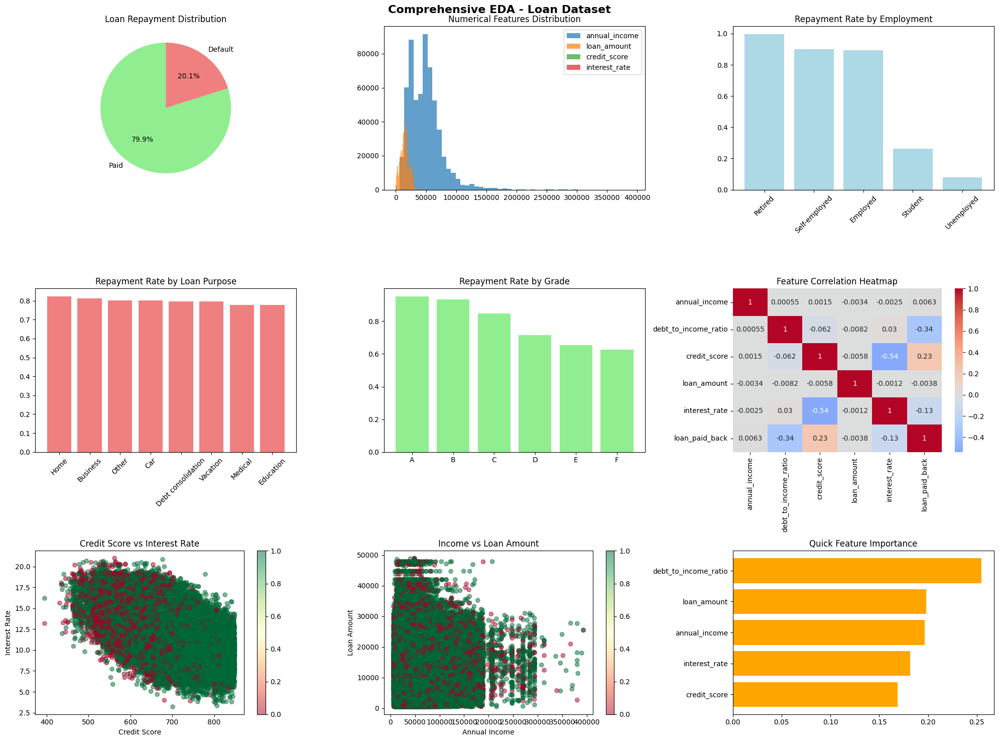


📊 KEY EDA INSIGHTS:
• Target Balance: 79.9% repaid
• Best Employment: Retired (99.7% repayment)
• Best Loan Purpose: Home (82.3% repayment)
• Strongest Correlation: Credit Score vs Interest Rate = -0.538
• Most Important Feature: debt_to_income_ratio (0.255)

🔧 APPLYING DOMAIN-DRIVEN FEATURE ENGINEERING

🔄 CONVERTING CATEGORICAL FEATURES TO NUMERIC
🔄 ENSURING ALL COLUMNS ARE NUMERIC
✅ Final feature engineering complete
   Training features: (593994, 48)
   Test features: (254569, 48)
   Feature dtypes: float64    25
int64      17
int32       6
Name: count, dtype: int64
Fitting leakage-free target encoding...

🔥 TRAINING XGB


xgb folds:  14%|█▍        | 1/7 [00:40<04:05, 40.86s/it]

  Fold 1: AUC = 0.922534 | Time = 40.9s


xgb folds:  29%|██▊       | 2/7 [01:25<03:35, 43.14s/it]

  Fold 2: AUC = 0.921218 | Time = 44.7s


xgb folds:  43%|████▎     | 3/7 [02:12<02:58, 44.67s/it]

  Fold 3: AUC = 0.920986 | Time = 46.5s


xgb folds:  57%|█████▋    | 4/7 [02:52<02:09, 43.16s/it]

  Fold 4: AUC = 0.919752 | Time = 40.9s


xgb folds:  71%|███████▏  | 5/7 [03:37<01:27, 43.68s/it]

  Fold 5: AUC = 0.919259 | Time = 44.6s


xgb folds:  86%|████████▌ | 6/7 [04:15<00:41, 41.75s/it]

  Fold 6: AUC = 0.920786 | Time = 38.0s


xgb folds: 100%|██████████| 7/7 [04:55<00:00, 42.15s/it]

  Fold 7: AUC = 0.920415 | Time = 39.5s

✅ XGB Summary:
  OOF AUC: 0.920700
  Fold AUCs: ['0.922534', '0.921218', '0.920986', '0.919752', '0.919259', '0.920786', '0.920415']
  Mean fold time: 42.2s



🔥 TRAINING LGB


lgb folds:   0%|          | 0/7 [00:00<?, ?it/s]

[LightGBM] [Info] Number of positive: 406709, number of negative: 102428
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.123553 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 7090
[LightGBM] [Info] Number of data points in the train set: 509137, number of used features: 52
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.798820 -> initscore=1.378938
[LightGBM] [Info] Start training from score 1.378938
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive ga

lgb folds:  14%|█▍        | 1/7 [03:09<18:55, 189.27s/it]

  Fold 1: AUC = 0.923142 | Time = 189.3s
[LightGBM] [Info] Number of positive: 406709, number of negative: 102428
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.123084 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 7090
[LightGBM] [Info] Number of data points in the train set: 509137, number of used features: 52
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.798820 -> initscore=1.378938
[LightGBM] [Info] Start training from score 1.378938
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Wa

lgb folds:  29%|██▊       | 2/7 [06:04<15:03, 180.73s/it]

  Fold 2: AUC = 0.922349 | Time = 174.7s
[LightGBM] [Info] Number of positive: 406709, number of negative: 102429
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.124220 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 7093
[LightGBM] [Info] Number of data points in the train set: 509138, number of used features: 52
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.798819 -> initscore=1.378928
[LightGBM] [Info] Start training from score 1.378928
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Wa

lgb folds:  43%|████▎     | 3/7 [09:01<11:57, 179.41s/it]

  Fold 3: AUC = 0.921896 | Time = 177.9s
[LightGBM] [Info] Number of positive: 406709, number of negative: 102429
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.122913 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 7093
[LightGBM] [Info] Number of data points in the train set: 509138, number of used features: 52
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.798819 -> initscore=1.378928
[LightGBM] [Info] Start training from score 1.378928
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Wa

lgb folds:  57%|█████▋    | 4/7 [11:53<08:49, 176.46s/it]

  Fold 4: AUC = 0.920898 | Time = 171.9s
[LightGBM] [Info] Number of positive: 406709, number of negative: 102429
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.125495 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 7090
[LightGBM] [Info] Number of data points in the train set: 509138, number of used features: 52
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.798819 -> initscore=1.378928
[LightGBM] [Info] Start training from score 1.378928
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Wa

lgb folds:  71%|███████▏  | 5/7 [14:34<05:41, 170.88s/it]

  Fold 5: AUC = 0.920207 | Time = 161.0s
[LightGBM] [Info] Number of positive: 406709, number of negative: 102429
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.131091 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 7090
[LightGBM] [Info] Number of data points in the train set: 509138, number of used features: 52
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.798819 -> initscore=1.378928
[LightGBM] [Info] Start training from score 1.378928
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Wa

lgb folds:  86%|████████▌ | 6/7 [17:25<02:50, 170.78s/it]

  Fold 6: AUC = 0.922248 | Time = 170.6s
[LightGBM] [Info] Number of positive: 406710, number of negative: 102428
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.129803 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 7093
[LightGBM] [Info] Number of data points in the train set: 509138, number of used features: 52
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.798821 -> initscore=1.378940
[LightGBM] [Info] Start training from score 1.378940
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Wa

lgb folds: 100%|██████████| 7/7 [20:20<00:00, 174.40s/it]

  Fold 7: AUC = 0.921534 | Time = 175.4s

✅ LGB Summary:
  OOF AUC: 0.921748
  Fold AUCs: ['0.923142', '0.922349', '0.921896', '0.920898', '0.920207', '0.922248', '0.921534']
  Mean fold time: 174.4s



🔥 TRAINING CTB


ctb folds:  14%|█▍        | 1/7 [06:27<38:47, 387.96s/it]

  Fold 1: AUC = 0.919552 | Time = 388.0s


ctb folds:  29%|██▊       | 2/7 [12:55<32:17, 387.45s/it]

  Fold 2: AUC = 0.918795 | Time = 387.1s


ctb folds:  43%|████▎     | 3/7 [18:51<24:52, 373.12s/it]

  Fold 3: AUC = 0.918579 | Time = 356.1s


ctb folds:  57%|█████▋    | 4/7 [24:52<18:25, 368.39s/it]

  Fold 4: AUC = 0.917514 | Time = 361.1s


ctb folds:  71%|███████▏  | 5/7 [30:02<11:34, 347.40s/it]

  Fold 5: AUC = 0.916578 | Time = 310.2s


ctb folds:  86%|████████▌ | 6/7 [36:29<06:00, 360.83s/it]

  Fold 6: AUC = 0.918622 | Time = 386.9s


ctb folds: 100%|██████████| 7/7 [42:57<00:00, 368.19s/it]

  Fold 7: AUC = 0.917699 | Time = 388.0s

✅ CTB Summary:
  OOF AUC: 0.918186
  Fold AUCs: ['0.919552', '0.918795', '0.918579', '0.917514', '0.916578', '0.918622', '0.917699']
  Mean fold time: 368.2s



🔥 TRAINING NN


nn folds:   0%|          | 0/7 [00:00<?, ?it/s]I0000 00:00:1762597864.545775      39 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 13904 MB memory:  -> device: 0, name: Tesla T4, pci bus id: 0000:00:04.0, compute capability: 7.5
I0000 00:00:1762597864.546516      39 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:1 with 13942 MB memory:  -> device: 1, name: Tesla T4, pci bus id: 0000:00:05.0, compute capability: 7.5
I0000 00:00:1762597877.872968     291 service.cc:148] XLA service 0x7b89f8019560 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1762597877.873613     291 service.cc:156]   StreamExecutor device (0): Tesla T4, Compute Capability 7.5
I0000 00:00:1762597877.873633     291 service.cc:156]   StreamExecutor device (1): Tesla T4, Compute Capability 7.5
I0000 00:00:1762597878.485616     291 cuda_dnn.cc:529] Loaded cuDNN version 90300
I0000 00:00:1762597883.69000

  Fold 1: AUC = 0.914201 | Time = 115.6s


nn folds:  29%|██▊       | 2/7 [03:42<09:13, 110.65s/it]

  Fold 2: AUC = 0.912875 | Time = 107.2s


nn folds:  43%|████▎     | 3/7 [05:42<07:39, 114.83s/it]

  Fold 3: AUC = 0.912864 | Time = 119.8s


nn folds:  57%|█████▋    | 4/7 [07:48<05:58, 119.35s/it]

  Fold 4: AUC = 0.911785 | Time = 126.3s


nn folds:  71%|███████▏  | 5/7 [09:36<03:50, 115.13s/it]

  Fold 5: AUC = 0.911018 | Time = 107.6s


nn folds:  86%|████████▌ | 6/7 [11:22<01:52, 112.14s/it]

  Fold 6: AUC = 0.913540 | Time = 106.3s


nn folds: 100%|██████████| 7/7 [13:21<00:00, 114.55s/it]

  Fold 7: AUC = 0.912777 | Time = 119.0s

✅ NN Summary:
  OOF AUC: 0.912669
  Fold AUCs: ['0.914201', '0.912875', '0.912864', '0.911785', '0.911018', '0.913540', '0.912777']
  Mean fold time: 114.6s



🎯 CREATING ADVANCED ENSEMBLE
Creating stacking ensemble...
  ridge meta-model AUC: 0.923001
  ridge_wide meta-model AUC: 0.923001
Selected ridge as meta-model with AUC: 0.923001

📊 FINAL RESULTS
Simple Weighted AUC: 0.919910
Model Performance:
  XGB: 0.920700 (weight: 0.251)
  LGB: 0.921748 (weight: 0.251)
  CTB: 0.918186 (weight: 0.250)
  NN: 0.912669 (weight: 0.248)

📈 CREATING FINAL VISUALIZATIONS



✅ SUBMISSION CREATED SUCCESSFULLY!
Target: 0.92824+ AUC
Current Ensemble OOF AUC: 0.919910
Submission shape: (254569, 2)
Predictions stats - Mean: 0.7998, Std: 0.2963


In [13]:
if __name__ == "__main__":
    main()